In [63]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from lazypredict.Supervised import LazyClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier

from pathlib import Path
from pandas_profiling import ProfileReport

In [2]:
# Read the data
df = pd.read_excel(Path('../data/Date_Fruit_Datasets.xlsx'))

In [13]:
df.head()

,AREA,PERIMETER,MAJOR_AXIS,MINOR_AXIS,ECCENTRICITY,EQDIASQ,SOLIDITY,CONVEX_AREA,EXTENT,ASPECT_RATIO,...,KurtosisRR,KurtosisRG,KurtosisRB,EntropyRR,EntropyRG,EntropyRB,ALLdaub4RR,ALLdaub4RG,ALLdaub4RB,Class
0,422163,2378.908,837.8484,645.6693,0.6373,733.1539,0.9947,424428,0.7831,1.2976,...,3.2370,2.9574,4.2287,-59191263232,-50714214400,-39922372608,58.7255,54.9554,47.8400,BERHI
1,338136,2085.144,723.8198,595.2073,0.5690,656.1464,0.9974,339014,0.7795,1.2161,...,2.6228,2.6350,3.1704,-34233065472,-37462601728,-31477794816,50.0259,52.8168,47.8315,BERHI
2,526843,2647.394,940.7379,715.3638,0.6494,819.0222,0.9962,528876,0.7657,1.3150,...,3.7516,3.8611,4.7192,-93948354560,-74738221056,-60311207936,65.4772,59.2860,51.9378,BERHI
3,416063,2351.210,827.9804,645.2988,0.6266,727.8378,0.9948,418255,0.7759,1.2831,...,5.0401,8.6136,8.2618,-32074307584,-32060925952,-29575010304,43.3900,44.1259,41.1882,BERHI
4,347562,2160.354,763.9877,582.8359,0.6465,665.2291,0.9908,350797,0.7569,1.3108,...,2.7016,2.9761,4.4146,-39980974080,-35980042240,-25593278464,52.7743,50.9080,42.6666,BERHI


In [5]:
profile = ProfileReport(df, title="Pandas Profiling Report", minimal=True)

In [6]:
profile.to_file("profile.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
pairplot = sns.pairplot(data=df, hue='Class')
pairplot.savefig('initial_pairplot.png')

In [22]:
# Separate features from labels
X = df.drop(['Class'], axis=1)
y = df['Class']

In [25]:
# Label encode our class
encoder = LabelEncoder()
encoder.fit(y)
y = encoder.transform(y)

In [26]:
# Split data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123, stratify=y)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=123, stratify=y_train)

In [39]:
# Initial model baseline
clf = LazyClassifier(verbose=0, ignore_warnings=True, predictions=True)
models, predictions = clf.fit(X_train, X_val, y_train, y_val)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 16.03it/s]


In [40]:
models

,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
CalibratedClassifierCV,0.92,0.90,None,0.92,0.21
LinearSVC,0.92,0.90,None,0.92,0.05
XGBClassifier,0.92,0.89,None,0.92,0.19
PassiveAggressiveClassifier,0.91,0.89,None,0.91,0.01
SVC,0.91,0.89,None,0.91,0.02
BaggingClassifier,0.90,0.88,None,0.90,0.05
LinearDiscriminantAnalysis,0.90,0.87,None,0.90,0.02
KNeighborsClassifier,0.90,0.87,None,0.90,0.02
LGBMClassifier,0.89,0.87,None,0.89,0.60


In [43]:
xgb = GradientBoostingClassifier()
xgb.fit(X_train, y_train)

GradientBoostingClassifier()

In [46]:
y_test_pred = xgb.predict(X_test)

In [49]:
y_val_pred = xgb.predict(X_val)

In [50]:
print(classification_report(y_val, y_val_pred))

              precision    recall  f1-score   support

           0       0.89      0.73      0.80        11
           1       0.81      0.76      0.79        17
           2       0.92      0.94      0.93        36
           3       0.92      0.92      0.92        12
           4       0.96      0.93      0.95        29
           5       1.00      0.97      0.99        35
           6       0.76      0.94      0.84        17

    accuracy                           0.91       157
   macro avg       0.89      0.89      0.89       157
weighted avg       0.91      0.91      0.91       157



In [59]:
conf_matrix = confusion_matrix(y_test, y_test_pred, normalize='true')

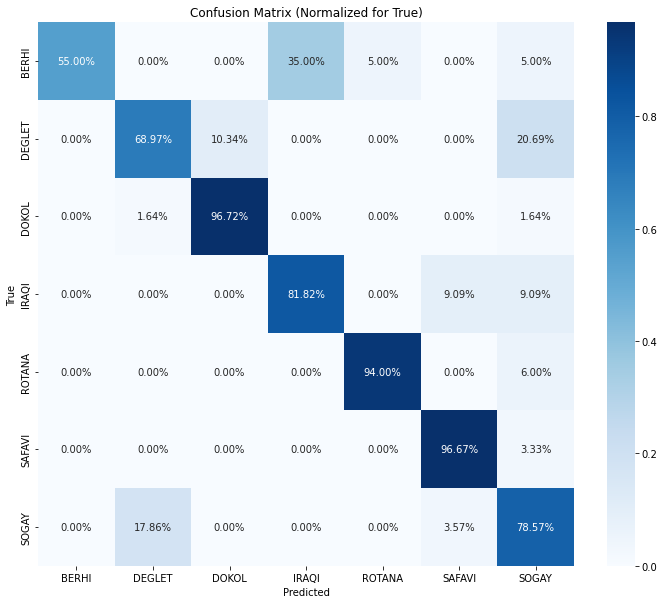

In [65]:
plt.figure(figsize=(12, 10))
sns.heatmap(conf_matrix, annot=True, fmt='.2%', cmap='Blues', yticklabels=encoder.classes_, xticklabels=encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (Normalized for True)')
plt.show()